**CSI 4106 Introduction to Artificial Intelligence** <br/>
*Assignment 2: Machine Learning*

# Identification

Name: Ismail Asaklil <br/>
Student Number: 300243534


# 1. Exploratory Analysis

## Data Exploration

In this assignment, we will utilize the Diabetes Prediction Dataset, accessible via [Diabetes Prediction Dataset](https://www.kaggle.com/datasets/iammustafatz/diabetes-prediction-dataset/data). To mitigate the complexity associated with Kaggle's login requirement, the dataset has been made available on a public GitHub repository:

- [github.com/turcotte/csi4106-f24/tree/main/assignments-data/a2](https://github.com/turcotte/csi4106-f24/tree/main/assignments-data/a2)

You can access and read the dataset directly from this GitHub repository in your Jupyter notebook.

In [3]:
# We first load necessary packages
import numpy as np
import pandas as pd
import altair as alt
import matplotlib.pyplot as plt
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.metrics import make_scorer, precision_score, recall_score, f1_score, accuracy_score
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

1. **Load the dataset and provide a summary of its structure**:

    - Describe the features (columns), their data types, and the target variable.

In [4]:
# Code cell
# Load the dataset and display the first few rows
df = pd.read_csv("https://raw.githubusercontent.com/turcotte/csi4106-f24/refs/heads/main/assignments-data/a2/diabetes_prediction_dataset.csv")
df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


In [5]:
# The types of the data in the columns
df.dtypes

gender                  object
age                    float64
hypertension             int64
heart_disease            int64
smoking_history         object
bmi                    float64
HbA1c_level            float64
blood_glucose_level      int64
diabetes                 int64
dtype: object

***Here a description of the features on the dataset***

**Attributes:**
1. **Gender:** Categorical variable indicating the sex of the individual ('male', 'female', or 'other').
2. **Age:** Float variable representing the individual's age.
3. **Hypertension:** Binary categorical variable indicating whether the individual has hypertension (1 = has hypertension, 0 = no hypertension).
4. **Heart Disease:** Binary categorical variable indicating whether the individual has heart disease (1 = has heart disease, 0 = no heart disease).
5. **Smoking History:** Multi-class categorical variable representing the individual's smoking history with the following categories:
   - 'not current' (previous smoker, but not currently),
   - 'never' (no smoking history),
   - 'former' (past smoker, not currently smoking),
   - 'ever' (has smoked at least once in the past but not currently),
   - 'current' (current smoker),
   - 'no info' (unclear smoking history).
6. **BMI:** Float variable representing the individual's Body Mass Index (kg/m²).
7. **HbA1c Level:** Float variable representing the individual's hemoglobin A1c level (percentage from 0-100%).
8. **Blood Glucose Level:** Integer variable representing blood glucose levels (mg/dL).

**Target Variable:**
1. **Diabetes:** Binary categorical variable indicating whether the individual has diabetes (1 = diabetic, 0 = non-diabetic).



2. **Feature Distribution Analysis**:

    - Examine the distribution of each feature using appropriate visualizations such as histograms and boxplots. Discuss insights gained, including the presence of outliers.

Let us first start by the categorical features which are gender, hypertension, heart disease, and smoking history.


In [6]:
# Preprocess data to count occurrences for each categorical variable
gender_counts = df['gender'].value_counts().reset_index()
gender_counts.columns = ['gender', 'count']

hypertension_counts = df['hypertension'].value_counts().reset_index()
hypertension_counts.columns = ['hypertension', 'count']

heart_disease_counts = df['heart_disease'].value_counts().reset_index()
heart_disease_counts.columns = ['heart_disease', 'count']

smoking_history_counts = df['smoking_history'].value_counts().reset_index()
smoking_history_counts.columns = ['smoking_history', 'count']

# Function to create a bar chart for a given column
def create_bar_chart(data, x_col, title):
    return alt.Chart(data).mark_bar().encode(  # Use mark_bar instead of markBar
        x=alt.X(x_col, title=x_col),
        y=alt.Y('count:Q', title='Count')
    ).properties(
        title=title,
        width=300,
        height=300
    )

# Creating individual charts using the preprocessed data
gender_chart = create_bar_chart(gender_counts, 'gender', "Gender")
hypertension_chart = create_bar_chart(hypertension_counts, 'hypertension', "Hypertension")
heart_disease_chart = create_bar_chart(heart_disease_counts, 'heart_disease', "Heart Disease")
smoking_history_chart = create_bar_chart(smoking_history_counts, 'smoking_history', "Smoking History")

# Combine the charts using vertical and horizontal concat
combined_chart = alt.vconcat(
    alt.hconcat(gender_chart, hypertension_chart),
    alt.hconcat(heart_disease_chart, smoking_history_chart)
).resolve_scale(
    y='shared'  # Use the same scale for y-axis across charts
)

# Display the combined chart
combined_chart

alt.VConcatChart(...)

Now let us see the distribution of the numerical features which are age, BMI, HbA1c level, and blood glucose level.

In [7]:
# Function to create a histogram for numerical variables
def create_histogram(data, column, title):
    return alt.Chart(data).mark_bar().encode(
        alt.X(column, bin=alt.Bin(maxbins=30), title=column),
        alt.Y('count()', title='Frequency')
    ).properties(
        title=title,
        width=300,
        height=300
    )

# Disable max row limit for Altair charts
alt.data_transformers.disable_max_rows()
# Creating individual histograms for each variable
age_hist = create_histogram(df, 'age', "Age")
bmi_hist = create_histogram(df, 'bmi', "BMI")
hba1c_hist = create_histogram(df, 'HbA1c_level', "HbA1c Level")
blood_glucose_hist = create_histogram(df, 'blood_glucose_level', "Blood Glucose Level")

# Combine the charts into 2 rows and 2 columns
combined_chart = alt.vconcat(
    alt.hconcat(age_hist, bmi_hist),
    alt.hconcat(hba1c_hist, blood_glucose_hist)
).resolve_scale(
    y='shared'  # Use the same scale for y-axis across charts
)

# Display the combined chart
combined_chart

alt.VConcatChart(...)

In [8]:
# Melt the dataframe to convert wide data to long data
df_melted = df.melt(value_vars=['age', 'bmi', 'HbA1c_level', 'blood_glucose_level'], 
                    var_name='variable', value_name='value')

# Create the combined boxplot
boxplot = alt.Chart(df_melted).mark_boxplot().encode(
    x=alt.X('variable:N', title='Variable'),  # Variable on the x-axis
    y=alt.Y('value:Q', title='Value'),        # Values on the y-axis
    color='variable:N'                        # Color by variable
).properties(
    title='Boxplot of Age, BMI, HbA1c Level, and Blood Glucose Level',
    width=400,
    height=400
)

# Display the combined boxplot
boxplot

alt.Chart(...)

In [9]:
#Get numeric columns
numeric_columns = ["HbA1c_level", "blood_glucose_level", "age", "bmi",]

#Print number of outliers for each column based on the IQR (excluding the risk level column)
for column in numeric_columns:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    # Apply outlier condition to the specific column
    outliers = (df[column] < Q1 - 1.5 * IQR) | (df[column] > Q3 + 1.5 * IQR)

    # Count the number of outliers
    num_outliers = outliers.sum()

    print(f"Outliers for '{column}': {num_outliers}")

Outliers for 'HbA1c_level': 1315
Outliers for 'blood_glucose_level': 2038
Outliers for 'age': 0
Outliers for 'bmi': 7086


For BMI, the histogram indicates that most values fall between 20 and 40, with the distribution skewed to the right. The boxplot highlights a significant number of outliers, both on the lower end (below 10) and the higher end (above 40). This suggests that while most people are either of normal weight or overweight, there are a few cases of obesity.

Looking at HbA1c level, most values are clustered around 6, with a notable number of values between 1 and 5 and fewer values above 7. The normal HbA1c level is below 5.7, indicating that some individuals have normal levels, others are slightly above normal, and very few have extremely high levels. The boxplot reveals that about 1300 individuals have HbA1c levels close to 9.

For the age feature, the histogram shows a relatively uniform distribution between ages 0 and 80, with no individuals older than 80 in the dataset. There don’t appear to be any noticeable outliers, as the distribution seems evenly spread across all age groups, which is further supported by the boxplot.

For blood glucose level, most values are below 200, with some falling under 100 and others between 125 and 175. This suggests that the majority of people have normal or slightly elevated blood glucose levels. There are a few cases where levels exceed 200, indicating very high blood glucose. The boxplot shows approximately 2000 outliers, with values ranging from above 250 to as high as 300.



3. **Target Variable Distribution**:

    - Analyze the distribution of the target variable to identify class imbalances. Use bar plots to visualize the class frequencies.

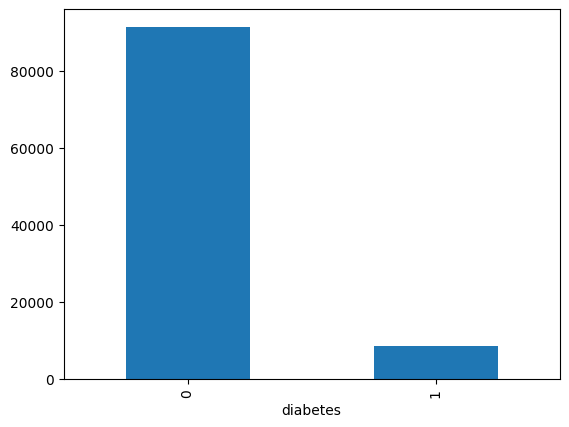

In [10]:
# Code cell
# We construct a bar chart that shows the distribution of the target variable
df['diabetes'].value_counts().plot(kind = "bar")
plt.show()

For the target variable, diabetes, the majority of individuals have a value of 0, indicating they do not have diabetes, while a smaller portion have a value of 1, meaning they are diabetic. This imbalance suggests that the dataset is skewed, with more non-diabetic cases than diabetic ones. As a result, accuracy alone would not be a reliable measure for evaluating models, since it might favor predicting non-diabetic cases. To address this, it's important to use metrics like precision, recall, and F-score to ensure that models don't overfit to the majority class and can effectively detect diabetic cases as well.

4. **Data Splitting**:

    - Split the dataset into training (80%) and test (20%) sets using the holdout method.

    - Ensure that this split occurs before any preprocessing to avoid data leakage.

In [11]:
# Code cell
# Code cell
X = df.drop(columns = ['diabetes'])
y = df['diabetes']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)

## Data Pre-Processing

5. **Categorical Variable Encoding**:

    - Encode any categorical variables. Justify the chosen method.

I have opted for one-hot encoding for the categorical variables gender and smoking history since they each contain multiple categories. 
I think its the best out of the other techniques in that case because it enhances the feature vector's dimensionality without imposing any artificial numerical relationships among the categories, thereby preserving the integrity of the data and avoiding potential biases.

In [12]:
# Code cell
# We do one-hot encoding on the categorical features

# For feature 'gender'
# First, encode the training set
print("Gender Categories:", df['gender'].unique())
gender_train = X_train[['gender']]
encoder_gender = preprocessing.OneHotEncoder(categories=[['Female', 'Male', 'Other']])
encoder_gender.fit(gender_train)
gender_encoded_train = encoder_gender.transform(gender_train).toarray()
X_train['female_gender'] = gender_encoded_train[:, 0]
X_train['male_gender'] = gender_encoded_train[:, 1]
X_train['other_gender'] = gender_encoded_train[:, 2]

# Now we encode the test set
gender_test = X_test[['gender']]
gender_encoded_test = encoder_gender.transform(gender_test).toarray()
X_test['female_gender'] = gender_encoded_test[:, 0]
X_test['male_gender'] = gender_encoded_test[:, 1]
X_test['other_gender'] = gender_encoded_test[:, 2]

# For feature 'smoking history'
# First, encode the training set
print("Smoking History Categories:", df['smoking_history'].unique())
smoking_train = X_train[['smoking_history']]
encoder_smoking = preprocessing.OneHotEncoder(categories=[['never', 'No Info', 'current', 'former', 'ever', 'not current']])
encoder_smoking.fit(smoking_train)
smoking_encoded_train = encoder_smoking.transform(smoking_train).toarray()
X_train['never_smoke'] = smoking_encoded_train[:, 0]
X_train['no_info_smoke'] = smoking_encoded_train[:, 1]
X_train['current_smoke'] = smoking_encoded_train[:, 2]
X_train['former_smoke'] = smoking_encoded_train[:, 3]
X_train['ever_smoke'] = smoking_encoded_train[:, 4]
X_train['not_current_smoke'] = smoking_encoded_train[:, 5]

# Now we encode the test set
smoking_test = X_test[['smoking_history']]
smoking_encoded_test = encoder_smoking.transform(smoking_test).toarray()
X_test['never_smoke'] = smoking_encoded_test[:, 0]
X_test['no_info_smoke'] = smoking_encoded_test[:, 1]
X_test['current_smoke'] = smoking_encoded_test[:, 2]
X_test['former_smoke'] = smoking_encoded_test[:, 3]
X_test['ever_smoke'] = smoking_encoded_test[:, 4]
X_test['not_current_smoke'] = smoking_encoded_test[:, 5]

Gender Categories: ['Female' 'Male' 'Other']
Smoking History Categories: ['never' 'No Info' 'current' 'former' 'ever' 'not current']


6. **Normalization/Standardization of Numerical Features**:

    - Normalize or standardize numerical features if necessary. Describe the technique used (e.g., Min-Max scaling, StandardScaler) and explain why it is suitable for this dataset.

    - Ensure that this technique is applied only to the training data, with the same transformation subsequently applied to the test data without fitting on it.

For the age feature, the histogram shows an approximately uniform distribution with no visible outliers, so min-max normalization is suitable. This method will scale the values between 0 and 1, which works well since age is naturally bounded and there are no extreme values in the dataset.

For BMI, standardization is a better choice due to the wide range of values and the presence of significant outliers. Standardization is more robust to outliers, ensuring they retain their influence without distorting the data. Since BMI doesn’t have natural bounds, standardization is appropriate.

Similarly, for HbA1c level and blood glucose level, standardization is preferred because these features also contain important outliers. These outliers, often linked to health risks like diabetes, should be preserved during scaling, which standardization allows. Min-max scaling, on the other hand, could distort the data by compressing values between the extreme outliers, potentially reducing the model's ability to capture meaningful variations in these features.

In summary, standardization is favored for BMI, HbA1c level, and blood glucose level to maintain the significance of outliers, while min-max scaling is appropriate for the age feature due to its uniform distribution and lack of extreme values.

In [13]:
# Code cell
# We now apply min-max normalization for the feature 'age'
age_train = X_train[['age']]
scaler_min_max = preprocessing.MinMaxScaler()
scaler_min_max.fit(age_train)
X_train['age_normalized'] = scaler_min_max.transform(age_train)

age_test = X_test[['age']]
X_test['age_normalized'] = scaler_min_max.transform(age_test)

# We now apply standardization for the features 'bmi', 'HbA1c_level', and 'blood_glucose_level'
features_train = X_train[['bmi', 'HbA1c_level', 'blood_glucose_level']]
scaler_standard = preprocessing.StandardScaler()
scaler_standard.fit(features_train)
scaled_train = scaler_standard.transform(features_train)
X_train['bmi_standardized'] = scaled_train[:, 0]
X_train['HbA1c_level_standardized'] = scaled_train[:, 1]
X_train['blood_glucose_level_standardized'] = scaled_train[:, 2]

features_test = X_test[['bmi', 'HbA1c_level', 'blood_glucose_level']]
scaled_test = scaler_standard.transform(features_test)
X_test['bmi_standardized'] = scaled_test[:, 0]
X_test['HbA1c_level_standardized'] = scaled_test[:, 1]
X_test['blood_glucose_level_standardized'] = scaled_test[:, 2]

## Model Development & Evaluation

7. **Model Development**:

    - Implement the machine learning models covered in class: Decision Trees, K-Nearest Neighbors (KNN), and Logistic Regression. Use the default parameters of scikit-learn as a baseline for training each model.

In [14]:
# Code cell
# Drop the original, unencoded features
X_train = X_train.drop(columns = ['gender', 'smoking_history'])
X_test = X_test.drop(columns = ['gender', 'smoking_history'])

# Drop the original, untransformed features
X_train = X_train.drop(columns = ['age', 'bmi', 'HbA1c_level', 'blood_glucose_level'])
X_test = X_test.drop(columns = ['age', 'bmi', 'HbA1c_level', 'blood_glucose_level'])

X_train

,hypertension,heart_disease,female_gender,male_gender,other_gender,never_smoke,no_info_smoke,current_smoke,former_smoke,ever_smoke,not_current_smoke,age_normalized,bmi_standardized,HbA1c_level_standardized,blood_glucose_level_standardized
75220,0,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.912412,-0.386474,-1.892451,-1.425157
48955,0,0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.000000,-0.412172,0.162169,0.170591
44966,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.474474,-0.452986,-1.425492,0.489740
13568,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.324324,-1.278339,-0.491574,-0.934157
92727,1,0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.762262,-0.788570,-0.958533,-1.302407
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6265,0,0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.612112,0.854578,0.162169,-1.425157
54886,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.186687,0.116900,-0.491574,0.514290
76820,0,0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.524525,-0.179380,0.255561,-1.302407
860,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.461962,-0.357753,0.629128,0.489740


In [15]:
X_test

,hypertension,heart_disease,female_gender,male_gender,other_gender,never_smoke,no_info_smoke,current_smoke,former_smoke,ever_smoke,not_current_smoke,age_normalized,bmi_standardized,HbA1c_level_standardized,blood_glucose_level_standardized
75721,0,0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.161662,-0.983570,0.255561,-0.295859
80184,0,0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.036537,-0.956361,-0.491574,0.170591
19864,0,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.787287,-0.303335,-1.892451,1.520838
76699,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.024024,-1.496015,0.535736,-0.295859
92991,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.411912,1.927839,0.629128,1.520838
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32595,0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.549550,-0.812756,0.442345,0.514290
29313,1,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.762262,2.215050,-1.892451,-1.179657
37862,0,0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.612112,-0.123450,-0.678357,-0.934157
53421,0,1,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.912412,-0.001007,1.002695,-0.934157


In [16]:
# Logistic Regression
lr = LogisticRegression(random_state=42)
lr.fit(X_train, y_train)

y_train_pred = lr.predict(X_train)

# Print the classification report
print("Logistic Regression Training Classification Report:")
print(classification_report(y_train, y_train_pred))

Logistic Regression Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      0.99      0.98     73208
           1       0.87      0.63      0.73      6792

    accuracy                           0.96     80000
   macro avg       0.92      0.81      0.86     80000
weighted avg       0.96      0.96      0.96     80000



In [17]:
# Decision tree
clf = tree.DecisionTreeClassifier(random_state=42)
clf.fit(X_train, y_train)

y_train_pred = clf.predict(X_train)

# Print the classification report
print("Decision Tree Training Classification Report:")
print(classification_report(y_train, y_train_pred))


Decision Tree Training Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     73208
           1       1.00      0.99      1.00      6792

    accuracy                           1.00     80000
   macro avg       1.00      1.00      1.00     80000
weighted avg       1.00      1.00      1.00     80000



In [18]:
# kNN
neigh = KNeighborsClassifier()
neigh.fit(X_train, y_train)

y_train_pred = neigh.predict(X_train)

# Print the classification report
print("kNN Training Classification Report:")
print(classification_report(y_train, y_train_pred))

kNN Training Classification Report:
              precision    recall  f1-score   support

           0       0.97      1.00      0.98     73208
           1       0.96      0.68      0.80      6792

    accuracy                           0.97     80000
   macro avg       0.96      0.84      0.89     80000
weighted avg       0.97      0.97      0.97     80000



8. **Model Evaluation**:

    - Use cross-validation to evaluate each model, justifying your choice of the number of folds.

    - Assess the models using metrics such as precision, recall, and F1-score.

In [19]:
# Code cell
# Create the scoring metrics
scoring = {
    'accuracy': make_scorer(accuracy_score),
    'precision': make_scorer(precision_score),
    'recall': make_scorer(recall_score),
    'f1_score': make_scorer(f1_score)
}

# Perform 5-fold cross validation for the three models
models = {
    'Decision Tree': clf,
    'kNN': neigh,
    'Logistic Regression': lr
}

# Perform cross-validation and store the results
model_scores = {}
for model_name, model in models.items():
    model_scores[model_name] = cross_validate(model, X_train, y_train, cv=5, scoring=scoring)

# Function to display the results for each model
def display_cv_results(model_name, scores):
    print(f"\nStatistics per fold ({model_name}):")
    print(f"{'Fold':<10} {'Accuracy':<10} {'Precision':<10} {'Recall':<10} {'F1-score':<10}")
    
    # Display the statistics for EACH fold
    for i in range(len(scores['test_accuracy'])):
        print(f"{i+1:<10} {scores['test_accuracy'][i]:<10.3f} {scores['test_precision'][i]:<10.3f} "
              f"{scores['test_recall'][i]:<10.3f} {scores['test_f1_score'][i]:<10.3f}")
    
    # Display the mean statistics across ALL folds
    print(f"\nMean statistics over all folds ({model_name}):")
    print(f"Mean Accuracy: {scores['test_accuracy'].mean():.3f}")
    print(f"Mean Precision: {scores['test_precision'].mean():.3f}")
    print(f"Mean Recall: {scores['test_recall'].mean():.3f}")
    print(f"Mean F1-Score: {scores['test_f1_score'].mean():.3f}")

# Loop through each model and display the results
for model_name, scores in model_scores.items():
    display_cv_results(model_name, scores)



Statistics per fold (Decision Tree):
Fold       Accuracy   Precision  Recall     F1-score  
1          0.950      0.696      0.728      0.712     
2          0.952      0.704      0.748      0.725     
3          0.952      0.712      0.738      0.725     
4          0.950      0.691      0.740      0.715     
5          0.952      0.708      0.733      0.720     

Mean statistics over all folds (Decision Tree):
Mean Accuracy: 0.951
Mean Precision: 0.702
Mean Recall: 0.737
Mean F1-Score: 0.719

Statistics per fold (kNN):
Fold       Accuracy   Precision  Recall     F1-score  
1          0.962      0.922      0.599      0.726     
2          0.963      0.897      0.634      0.743     
3          0.962      0.907      0.619      0.736     
4          0.963      0.912      0.631      0.746     
5          0.962      0.899      0.625      0.738     

Mean statistics over all folds (kNN):
Mean Accuracy: 0.962
Mean Precision: 0.907
Mean Recall: 0.622
Mean F1-Score: 0.738

Statistics per fold

I performed a 5-fold cross-validation on all models due to the large training set, allowing for efficient training and testing with sufficient data vand because 5-fold cross validation allows each iteration to have 80% of the data as training set and 20% as test set. While all models achieved over 95% accuracy, this metric was misleading due to class imbalance. I found that the decision tree classifier had lower precision but significantly higher recall (mean recall of 74.3%), correctly identifying more diabetic individuals. In a medical context, recall is prioritized over precision, so I concluded that the decision tree model is the most effective choice for predicting diabetes, given its superior recall and competitive F1-scores.

## Hyperparameter Optimization

9. **Exploration and Performance Evaluation:**

    - Investigate the impact of varying hyperparameter values on the performance of each model.

    - Focus on the following relevant hyperparameters for each model:

        - [DecisionTreeClassifier](https://scikit-learn.org/dev/modules/generated/sklearn.tree.DecisionTreeClassifier.html): `criterion` and `max_depth`.
  
        - [LogisticRegression](https://scikit-learn.org/1.5/modules/generated/sklearn.linear_model.LogisticRegression.html): `penalty`, `max_iter`, and `tol`.
  
        - [KNeighborsClassifier](https://scikit-learn.org/dev/modules/generated/sklearn.neighbors.KNeighborsClassifier.html): `n_neighbors` and `weights`.

    - Employ a grid search strategy or utilize scikit-learn's built-in methods to thoroughly evaluate all combinations of hyperparameter values. Cross-validation should be used to assess each combination.

    - Quantify the performance of each hyperparameter configuration using precision, recall, and F1-score as metrics.

    - Display the results in a tabular or graphical format (e.g., line charts, bar charts) to effectively demonstrate the influence of hyperparameter variations on model performance.

    - Specify the default values for each hyperparameter tested.

    - Analyze the findings and offer insights into which hyperparameter configurations achieved optimal performance for each model.

##### DecisionTreeClassifier

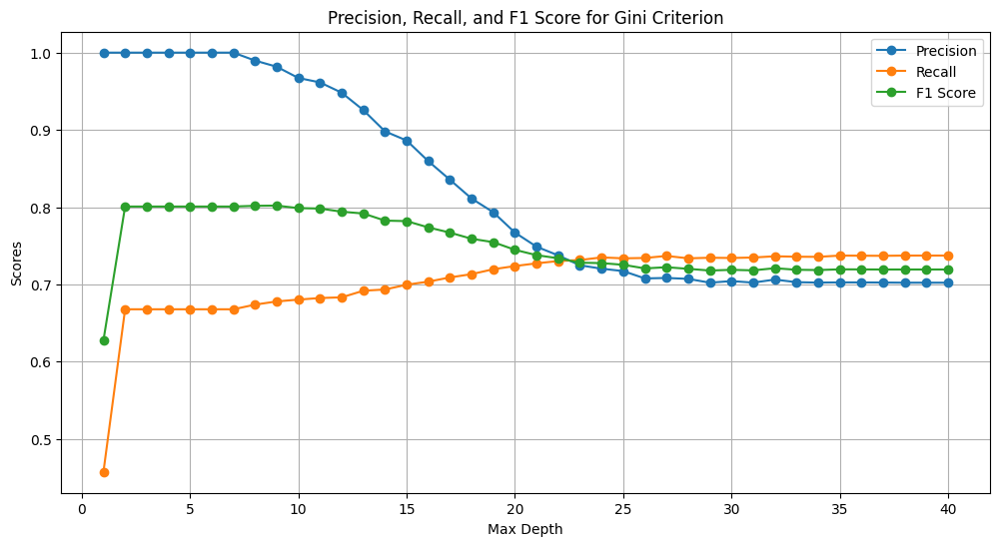

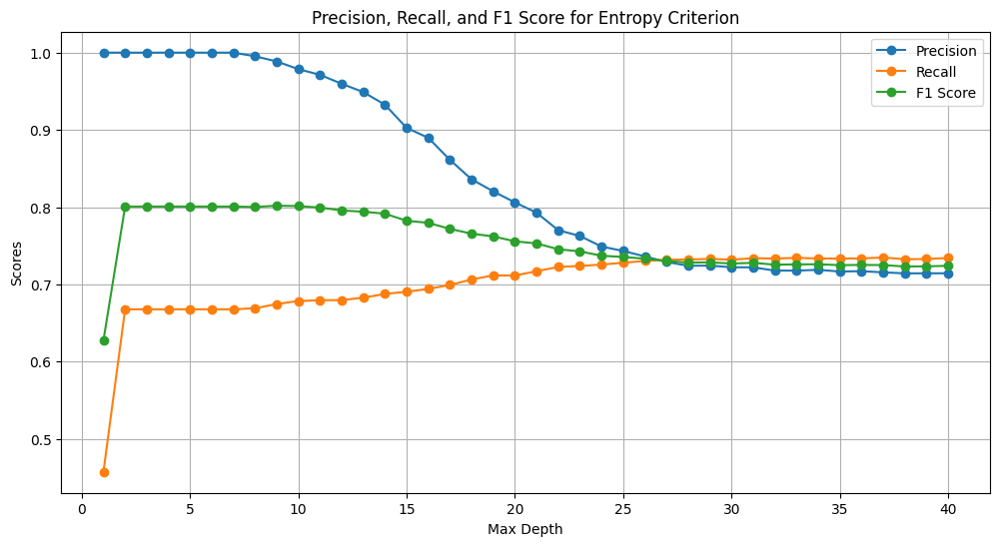

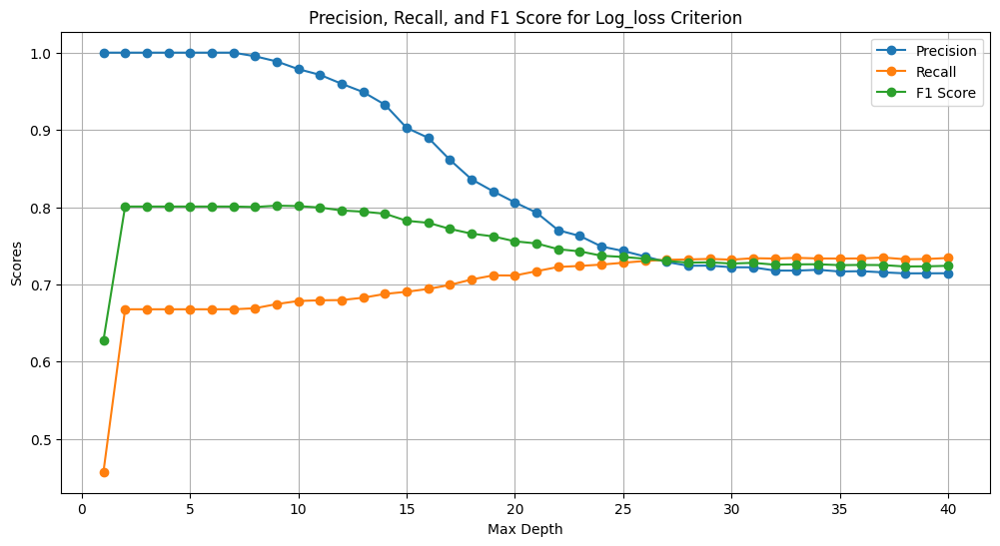

In [20]:
# Code cell
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt

# Define scoring metrics
scoring = {
    'precision': make_scorer(precision_score),
    'recall': make_scorer(recall_score),
    'f1_score': make_scorer(f1_score)
}

# 1. DecisionTreeClassifier
param_grid_dt = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': range(1, 41)
}

grid_search_dt = GridSearchCV(clf, param_grid_dt, cv=5, scoring=scoring, refit='f1_score')
grid_search_dt.fit(X_train, y_train)

# Initialize a dictionary to store scores for each criterion and max_depth combination
results = {criterion: {'precision': [], 'recall': [], 'f1_score': []} for criterion in ['gini', 'entropy', 'log_loss']}

# Loop over each criterion to extract metrics for each value of max_depth
for criterion in results.keys():
    for depth in param_grid_dt['max_depth']:
        # Find index for the current criterion and max_depth
        indices = [
            i for i, params in enumerate(grid_search_dt.cv_results_['params'])
            if params['criterion'] == criterion and params['max_depth'] == depth
        ]
        
        if indices:  # Check if indices is not empty
            index = indices[0]
            results[criterion]['precision'].append(grid_search_dt.cv_results_['mean_test_precision'][index])
            results[criterion]['recall'].append(grid_search_dt.cv_results_['mean_test_recall'][index])
            results[criterion]['f1_score'].append(grid_search_dt.cv_results_['mean_test_f1_score'][index])
        else:
            # Append None or a suitable placeholder if not found
            results[criterion]['precision'].append(None)
            results[criterion]['recall'].append(None)
            results[criterion]['f1_score'].append(None)

# Plotting each criterion separately with smoothed lines
for criterion in results.keys():
    fig, ax = plt.subplots(figsize=(12, 6))

    # Plot smoothed lines for precision, recall, and f1-scores for each max_depth value
    ax.plot(param_grid_dt['max_depth'], results[criterion]['precision'], label='Precision', marker='o')
    ax.plot(param_grid_dt['max_depth'], results[criterion]['recall'], label='Recall', marker='o')
    ax.plot(param_grid_dt['max_depth'], results[criterion]['f1_score'], label='F1 Score', marker='o')

    # Add labels, title, and legend
    ax.set_xlabel('Max Depth')
    ax.set_ylabel('Scores')
    ax.set_title(f'Precision, Recall, and F1 Score for {criterion.capitalize()} Criterion')
    ax.legend()
    ax.grid(True)  # Optional: add a grid for better readability

    # Show plot
    plt.show()


In [21]:
# Extract the best index and best parameters
best_index = grid_search_dt.best_index_
best_params = grid_search_dt.best_params_

# Print the results
print("Decision Tree Best Parameters:")
for param, value in best_params.items():
    print(f"  {param}: {value}")

print("\nDecision Tree Metrics at Best Parameters:")
print(f"  Best F1 Score: {grid_search_dt.cv_results_['mean_test_f1_score'][best_index]:.4f}")
print(f"  Precision: {grid_search_dt.cv_results_['mean_test_precision'][best_index]:.4f}")
print(f"  Recall: {grid_search_dt.cv_results_['mean_test_recall'][best_index]:.4f}")

Decision Tree Best Parameters:
  criterion: gini
  max_depth: 9

Decision Tree Metrics at Best Parameters:
  Best F1 Score: 0.8020
  Precision: 0.9817
  Recall: 0.6780


The model achieves an accuracy of 96% on the test dataset, which is comparable to the 97% mean accuracy observed during cross-validation. Both the test and cross-validation datasets show a precision of approximately 82% for the positive diabetes class, indicating that 82% of predictions for diabetic individuals are correct. The recall for the test dataset is slightly higher at 72%, while the mean recall from cross-validation is about 71%. The F1 scores for both models are also similar. 
Notably, the model with the highest F1 score employs the Gini criterion at a maximum depth of 9, achieving near-perfect precision but only around 67% recall. This outcome suggests that despite its strong precision, this model may not be the best choice due to its insufficient recall, highlighting the need for a careful selection of depth in pursuit of effective diabetes prediction.

##### Logistic Regression 

In [25]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer, precision_score, recall_score, f1_score
from scipy.stats import loguniform
import numpy as np
from sklearn.model_selection import GridSearchCV
import warnings

# Suppress warnings
warnings.filterwarnings('ignore')

# Define the scoring metrics
scoring = {
    'precision': make_scorer(precision_score),
    'recall': make_scorer(recall_score),
    'f1': make_scorer(f1_score)
}

# Define the hyperparameter grid for Logistic Regression
param_grid = {
    'tol': np.logspace(-4, -2, num=3),  # Tolerance for stopping criteria (log-spaced)
    'max_iter': [20, 50, 200, 1000, 2000],  # Maximum number of iterations
    'penalty': [None, 'l1', 'l2', 'elasticnet'],  # Regularization penalty
    'l1_ratio': [0.5]  # Ratio for elasticnet penalty
}

# Initialize Logistic Regression with 'saga' solver (suitable for large datasets)
clf_lr = LogisticRegression(solver='saga')

# Perform Grid Search for hyperparameter tuning with cross-validation
grid_search_lr = GridSearchCV(clf_lr, param_grid, cv=5, scoring=scoring, refit='f1', return_train_score=True)
grid_search_lr.fit(X_train, y_train)




GridSearchCV(cv=5, estimator=LogisticRegression(solver='saga'),
             param_grid={'l1_ratio': [0.5],
                         'max_iter': [20, 50, 200, 1000, 2000],
                         'penalty': [None, 'l1', 'l2', 'elasticnet'],
                         'tol': array([0.0001, 0.001 , 0.01  ])},
             refit='f1', return_train_score=True,
             scoring={'f1': make_scorer(f1_score, response_method='predict'),
                      'precision': make_scorer(precision_score, response_method='predict'),
                      'recall': make_scorer(recall_score, response_method='predict')})

In [26]:
def display_best_params(grid_search):
    """Display the best parameters and F1 score from grid search."""
    print("Best Parameters:", grid_search.best_params_)
    print("Best F1 Score:", grid_search.best_score_)

def process_results(grid_search):
    """Convert cv_results_ to a DataFrame, process and sort it."""
    results_df = pd.DataFrame(grid_search.cv_results_)
    results_df['param_penalty'] = results_df['param_penalty'].apply(lambda x: 'none' if x is None else x)
    return results_df.sort_values(by='mean_test_f1', ascending=False)

def print_grouped_results(results_df):
    """Group results by penalty and print detailed statistics."""
    for penalty, group in results_df.groupby('param_penalty'):
        print(f"\nStatistics for Penalty: {penalty}")
        print(f"{'Tolerance (tol)':<20} {'Max Iterations':<20} {'Mean Precision':<20} "
              f"{'Mean Recall':<20} {'Mean F1 Score':<20}")
        print("-" * 100)

        # Sort by F1 score in descending order and print each row
        for _, row in group.sort_values(by='mean_test_f1', ascending=False).iterrows():
            print(f"{row['param_tol']:<20.4f} {row['param_max_iter']:<20} "
                  f"{row['mean_test_precision']:<20.3f} {row['mean_test_recall']:<20.3f} "
                  f"{row['mean_test_f1']:<20.3f}")

# Execute the functions
display_best_params(grid_search_lr)
sorted_results_df = process_results(grid_search_lr)
print_grouped_results(sorted_results_df)


Best Parameters: {'l1_ratio': 0.5, 'max_iter': 200, 'penalty': None, 'tol': np.float64(0.01)}
Best F1 Score: 0.7322246437134667
Best Parameters: {'l1_ratio': 0.5, 'max_iter': 200, 'penalty': None, 'tol': np.float64(0.01)}
Best F1 Score: 0.7322246437134667

Statistics for Penalty: elasticnet
Tolerance (tol)      Max Iterations       Mean Precision       Mean Recall          Mean F1 Score       
----------------------------------------------------------------------------------------------------
0.0100               200                  0.871                0.630                0.731               
0.0100               50                   0.872                0.629                0.731               
0.0100               20                   0.871                0.630                0.731               
0.0100               1000                 0.870                0.630                0.731               
0.0001               20                   0.870                0.630              

It is shown here that no matter the number of iterations, tolerance level ... All the f1-scores are apprx the same. We can also notice that the models that uses L1 , L2 as a combo perform better in general but we can say which one is optimal because the differences are so minimal. 

##### KNeighborsClassifier

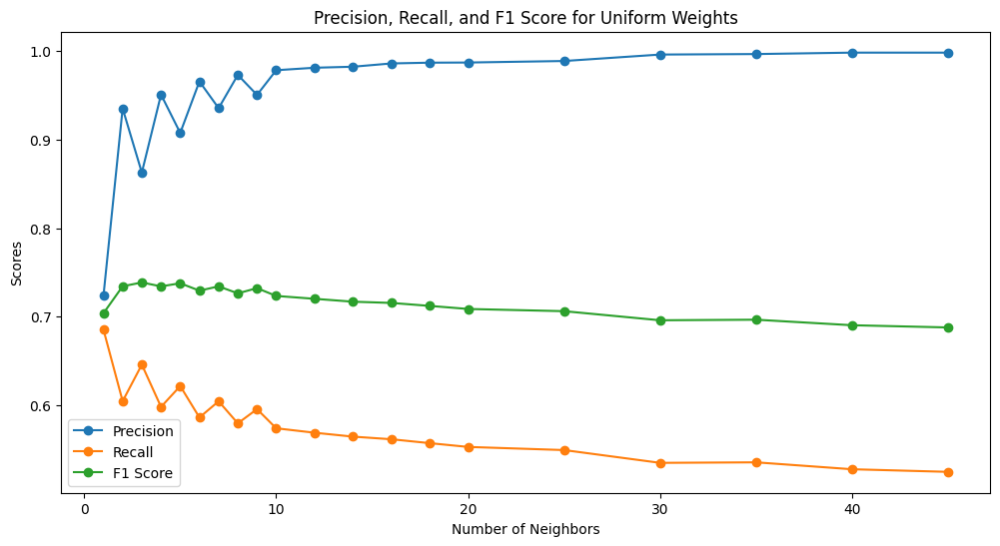

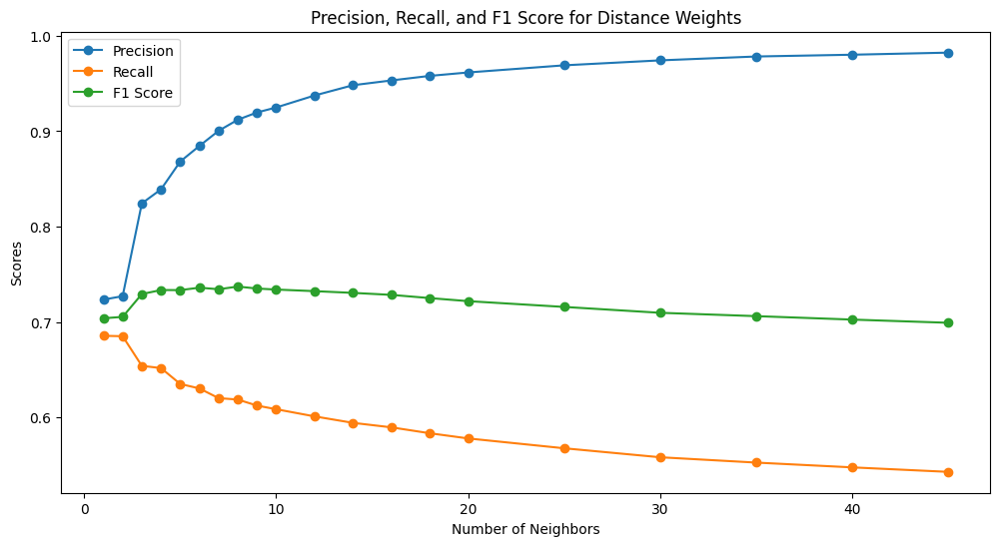

In [27]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, precision_score, recall_score, f1_score
import matplotlib.pyplot as plt

def define_scoring_metrics():
    """Define scoring metrics for model evaluation."""
    return {
        'precision': make_scorer(precision_score),
        'recall': make_scorer(recall_score),
        'f1_score': make_scorer(f1_score)
    }

def create_param_grid():
    """Create hyperparameter grid for KNeighborsClassifier."""
    weights = ['uniform', 'distance']
    n_neighbors_range = list(range(1, 11)) + list(range(12, 21, 2)) + list(range(25, 50, 5))
    return {
        'n_neighbors': n_neighbors_range,
        'weights': weights
    }

def perform_grid_search(X_train, y_train, param_grid, scoring):
    """Perform grid search for hyperparameter tuning."""
    clf_knn = KNeighborsClassifier()
    grid_search_knn = GridSearchCV(clf_knn, param_grid, cv=5, scoring=scoring, refit='f1_score')
    grid_search_knn.fit(X_train, y_train)
    return grid_search_knn

def extract_results(grid_search):
    """Extract precision, recall, and F1 scores from grid search results."""
    weights = grid_search.param_grid['weights']
    n_neighbors_range = grid_search.param_grid['n_neighbors']
    
    results_knn = {weight: {'precision': [], 'recall': [], 'f1_score': []} for weight in weights}

    for weight in weights:
        for neighbors in n_neighbors_range:
            index = [
                i for i, params in enumerate(grid_search.cv_results_['params'])
                if params['weights'] == weight and params['n_neighbors'] == neighbors
            ][0]

            results_knn[weight]['precision'].append(grid_search.cv_results_['mean_test_precision'][index])
            results_knn[weight]['recall'].append(grid_search.cv_results_['mean_test_recall'][index])
            results_knn[weight]['f1_score'].append(grid_search.cv_results_['mean_test_f1_score'][index])

    return results_knn

def plot_results(results_knn, n_neighbors_range):
    """Plot precision, recall, and F1 scores for different weights."""
    for weight, scores in results_knn.items():
        fig, ax = plt.subplots(figsize=(12, 6))
        
        ax.plot(n_neighbors_range, scores['precision'], label='Precision', marker='o')
        ax.plot(n_neighbors_range, scores['recall'], label='Recall', marker='o')
        ax.plot(n_neighbors_range, scores['f1_score'], label='F1 Score', marker='o')

        ax.set_xlabel('Number of Neighbors')
        ax.set_ylabel('Scores')
        ax.set_title(f'Precision, Recall, and F1 Score for {weight.capitalize()} Weights')
        ax.legend()
        plt.show()

# Main execution
scoring = define_scoring_metrics()
param_grid = create_param_grid()
grid_search_knn = perform_grid_search(X_train, y_train, param_grid, scoring)
results_knn = extract_results(grid_search_knn)
plot_results(results_knn, param_grid['n_neighbors'])


In [28]:
def print_knn_results(grid_search):
    """Print the best parameters and corresponding scores from KNN grid search."""
    best_params = grid_search.best_params_
    best_index = grid_search.best_index_

    print("KNN Best Params:", best_params)
    print("KNN Best F1 Score:", grid_search.cv_results_['mean_test_f1_score'][best_index])
    print("KNN Precision:", grid_search.cv_results_['mean_test_precision'][best_index])
    print("KNN Recall:", grid_search.cv_results_['mean_test_recall'][best_index])

# Call the function to print the KNN results
print_knn_results(grid_search_knn)


KNN Best Params: {'n_neighbors': 3, 'weights': 'uniform'}
KNN Best F1 Score: 0.7386457802508154
KNN Precision: 0.8626757074740562
KNN Recall: 0.6459040856733217


In analyzing the KNeighborsClassifier with both distance and uniform weights, I found that the choice of weights had little impact on the overall results, though uniform weights tended to yield more erratic performance. Initially, using one neighbor produced consistent metrics around 0.7. However, as I increased the number of neighbors, precision saw a marked rise, while recall began to drop after reaching about 10 neighbors. This trend suggests that exceeding 10 neighbors may not be advantageous, particularly given the emphasis on recall for accurately identifying diabetes cases.

For optimal results, I would recommend models using between 2 to 5 neighbors. This range balances high precision with acceptable recall and maintains a stable F1-score. Furthermore, I observed that models employing distance weights generally outperformed those with uniform weights due to their consistency.

The model that achieved the best F1-score utilized 5 neighbors with uniform weights, resulting in approximately 90% precision, 62% recall, and a 73% F1-score. However, the low recall indicates that relying solely on the highest F1-score could lead to suboptimal model selection.

Default Hyperparameters:

- DecisionTreeClassifier: criterion='gini', max_depth=None
- LogisticRegression: penalty='l2', max_iter=100, tol=1e-4
- KNeighborsClassifier: n_neighbors=5, weights='uniform'

## Analysis of Results

10. **Model Comparison**:

    - Compare the results obtained from each model.

    - Discuss observed differences in model performance, providing potential explanations. Consider aspects such as model complexity, data imbalance, overfitting, and the impact of parameter tuning on overall results.

    - Provide recommendations on which model(s) to choose for this task and justify your choices based on the analysis results.

    - Train the recommended model(s) using the optimal parameter values identified from the parameter optimization step. Subsequently, apply the trained model to the test data. Document your observations comprehensively. Specifically, evaluate whether the results derived from cross-validation are consistent with those obtained from the test set.

In this analysis, I compare the performance of decision trees, k-nearest neighbors (kNN), and logistic regression models in predicting diabetes. While I previously examined the overall model comparisons, here I focus specifically on the results from the different training methods.

Initially, decision tree models exhibit high precision, which gradually decreases as the tree's depth increases. Conversely, the recall scores improve with greater depth, and even at lower depths, decision trees consistently outperform both kNN and logistic regression by at least 5% in recall. Notably, decision trees achieve the highest f1-score among all models, exceeding the scores of kNN and logistic regression by over 7%.

The kNN models display high precision but suffer from low recall, resulting in a lower f1-score, particularly as the number of neighbors increases. Logistic regression also shows decent precision at around 87%, but like kNN, it struggles with low recall.

Overall, decision tree models stand out as the most effective for this task. Their superior recall is crucial for diabetes prediction, as it ensures more individuals with diabetes are accurately identified, allowing for timely treatment.

When selecting a specific decision tree model, it's essential to avoid both underfitting and overfitting, which can occur with excessively low or high tree depths, respectively. While high precision is valuable, recall takes precedence in this context. Therefore, I recommend a decision tree model with a depth of 19 using the entropy criterion, which yields a recall of approximately 70%, precision of around 80%, and an f1-score of about 75%.

In [23]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, make_scorer, accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import cross_validate

# Function to train and evaluate the decision tree model
def train_and_evaluate_decision_tree(X_train, y_train, X_test, y_test, criterion, max_depth):
    # Initialize and fit the decision tree model with the optimal hyperparameters
    model = DecisionTreeClassifier(criterion=criterion, max_depth=max_depth, random_state=42)
    model.fit(X_train, y_train)
    
    # Make predictions on the test dataset
    y_pred = model.predict(X_test)
    
    # Print the classification report
    print("Decision Tree Model on Test Dataset:\n", classification_report(y_test, y_pred))
    
    return model

# Function to perform cross-validation and display mean statistics
def cross_validate_model(model, X_train, y_train):
    scoring = {
        'accuracy': make_scorer(accuracy_score),
        'precision': make_scorer(precision_score),
        'recall': make_scorer(recall_score),
        'f1_score': make_scorer(f1_score)
    }
    
    # Perform 5-fold cross-validation
    clf_scores = cross_validate(model, X_train, y_train, cv=5, scoring=scoring)
    
    # Display mean statistics
    print("\nMean statistics over all folds (Decision Tree with Cross Validation):")
    print(f"Mean Accuracy: {clf_scores['test_accuracy'].mean():.3f}")
    print(f"Mean Precision: {clf_scores['test_precision'].mean():.3f}")
    print(f"Mean Recall: {clf_scores['test_recall'].mean():.3f}")
    print(f"Mean F1-Score: {clf_scores['test_f1_score'].mean():.3f}")

# Optimal hyperparameters obtained from grid search
optimal_criterion = grid_search_dt.best_params_['criterion']
optimal_max_depth = grid_search_dt.best_params_['max_depth']

# Train and evaluate the model
optimal_tree_model = train_and_evaluate_decision_tree(X_train, y_train, X_test, y_test, optimal_criterion, optimal_max_depth)

# Perform cross-validation on the trained model
cross_validate_model(optimal_tree_model, X_train, y_train)


Decision Tree Model on Test Dataset:
               precision    recall  f1-score   support

           0       0.97      1.00      0.98     18292
           1       0.99      0.68      0.81      1708

    accuracy                           0.97     20000
   macro avg       0.98      0.84      0.90     20000
weighted avg       0.97      0.97      0.97     20000


Mean statistics over all folds (Decision Tree with Cross Validation):
Mean Accuracy: 0.972
Mean Precision: 0.982
Mean Recall: 0.678
Mean F1-Score: 0.802


## 2. Documentation of Exploratory Analysis

The report should comprehensively document the entire process followed during this assignment. The Jupyter Notebook must include the following:

- Your name(s), student number(s), and a report title.
- Explain how the tasks have been split between the members. How did you make sure that both students achieve the learning outcomes? 
- A section for each step of the exploratory analysis, containing the relevant Python code and explanations or results.
  - For sections requiring Python code, include the code in a cell.
  - For sections requiring explanations or results, include these in a separate cell or in combination with code cells.
- Ensure logical separation of code into different cells. For example, the definition of a function should be in one cell and its execution in another. Avoid placing too much code in a single cell to maintain clarity and readability.
- The notebook you submit must include the results of the execution, complete with graphics, ensuring that the teaching assistant can grade the notebook without needing to execute the code.

# Resources

Ismail Asaklil : 300243534
I did all the assigment by myself since im alone in the group 